<a href="https://colab.research.google.com/github/aashasandeep/User-Analytics-in-the-Telecommunication-Industry---Overview/blob/main/Telcom_data_Task_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Import necessery liabraries**

In [ ]:
import pandas as pandas

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# to visualise all the columns and rows in the dataframe

In [ ]:
pd.pandas.set_option('display.max_columns',None)
pd.pandas.set_option('display.max_rows',None)

In [ ]:
import statsmodels.stats.api as sms
import warnings
warnings.filterwarnings("ignore")

Task 1 - User Overview Analysis

In [ ]:
Telcom_data = pd.read_excel('/content/Cleaned_telcom_data (1).xlsx')

Data Exploration and Understanding

In [ ]:
Telcom_data.head()

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Handset Manufacturer,Handset Type,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
0,13114483460844900352,2019-04-04 12:01:18,770,2019-04-25 14:35:31,662,1823652,208201448079117,33664962239,35521209507511,9164566995485190,42,5,23,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,37624.0,38787.0,1823652892,Samsung,Samsung Galaxy A5 Sm-A520F,128,52,164,8,288,8,213,214,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741,308879636.0
1,13114483482878900224,2019-04-09 13:04:04,235,2019-04-25 08:15:48,606,1365104,208201909211140,33681854413,35794009006359,L77566A,65,5,16,26,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,168.0,3560.0,1365104371,Samsung,Samsung Galaxy J5 (Sm-J530),128,52,164,8,288,8,971,1022,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391,653384965.0
2,13114483484080500736,2019-04-09 17:42:11,1,2019-04-25 11:58:13,652,1361762,208200314458056,33760627129,35281510359387,D42335A,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1361762651,Samsung,Samsung Galaxy A8 (2018),128,52,164,8,288,8,751,695,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638,279807335.0
3,13114483485442799616,2019-04-10 00:31:25,486,2019-04-25 07:36:35,171,1321509,208201402342131,33750343200,35356610164913,T21824A,45,5,44,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,3330.0,37882.0,1321509685,undefined,undefined,128,52,164,8,288,8,17,207,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218,846028530.0
4,13114483499480700928,2019-04-12 20:10:23,565,2019-04-25 10:40:32,954,1089009,208201401415120,33699795932,35407009745539,D88865A,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1089009389,Samsung,Samsung Sm-G390F,128,52,164,8,288,8,607,604,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814,569138589.0


In [ ]:
Telcom_data.tail()

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Handset Manufacturer,Handset Type,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
149996,7277825670196679680,2019-04-29 07:28:42,451,2019-04-30 06:02:33,214,81230,208202201200072,33650688697,35483109451938,D20434A,32,0,52,65,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,42376.0,41915.0,81230763,Apple,Apple iPhone 8 Plus (A1897),128,52,164,8,288,8,223,229,3.464974e+06,52091.00000,9.967603e+06,2.817311e+06,5.763900e+04,633237.00000,1.619167e+07,1.176343e+07,1.788370e+07,1.967816e+07,5.266097e+08,9.197207e+06,3.264510e+06,1.348742e+07,57628851,574175259.0
149997,7349883264234609664,2019-04-29 07:28:42,483,2019-04-30 10:41:33,187,97970,208201908153249,33663449963,35660508296467,D10223C,27,2,23,54,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,17264.0,16759.0,97970704,Apple,Apple iPhone Se (A1723),128,52,164,8,288,8,105,102,2.344568e+06,7613.00000,2.229420e+06,2.185941e+06,1.954414e+06,167304.00000,1.387723e+07,8.288284e+06,1.935015e+07,2.129315e+07,6.268931e+08,4.735033e+06,7.121804e+08,2.457758e+06,39135081,666648844.0
149998,13114483573367300096,2019-04-29 07:28:43,283,2019-04-30 10:46:12,810,98249,208201711161187,33621890103,35721209870907,T51102A,43,6,43,47,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,25003.0,28640.0,98249527,Apple,Apple iPhone Xs (A2097),128,52,164,8,288,8,104,108,1.245845e+06,14394.00000,3.850890e+06,2.734579e+06,1.525734e+06,532543.00000,2.266051e+07,1.855903e+06,9.963942e+06,5.065760e+06,5.535395e+08,1.339432e+07,1.211009e+08,1.131473e+07,34912224,592786405.0
149999,13114483573367300096,2019-04-29 07:28:43,696,2019-04-30 10:40:34,327,97910,208202101098075,33619622058,86186204011457,L88342B,37,5,34,37,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,13405.0,34088.0,97910631,Huawei,Huawei Fig-Lx1,128,52,164,8,288,8,43,82,8.015470e+05,21562.00000,4.189773e+06,3.567494e+06,2.228270e+06,622644.00000,8.817106e+06,8.305402e+06,3.322253e+06,1.317259e+07,3.525370e+08,2.529475e+06,8.147131e+08,1.406930e+06,29626096,371895920.0
150000,,2019-04-29 07:08:38,499,2019-04-25 00:01:32,500,86399,208201546329113,33663706799,35722009426311,Unknown,45,5,63,63,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,39304.5,46793.5,86399983,Unknown,Unknown,128,52,164,8,288,8,203,217,1.795322e+06,32928.43438,5.750753e+06,2.056542e+06,1.791729e+06,467373.44194,1.163407e+07,1.100941e+07,1.162685e+07,1.100175e+07,4.220447e+08,8.288398e+06,4.211005e+08,8.264799e+06,41143312,455841077.5


In [ ]:
top_10_handsets = Telcom_data['Handset Type'].value_counts().head(10)
print("Top 10 Handsets:")
print(top_10_handsets)

Top 10 Handsets:
Handset Type
Huawei B528S-23A                19752
Apple iPhone 6S (A1688)          9419
Apple iPhone 6 (A1586)           9023
undefined                        8987
Apple iPhone 7 (A1778)           6326
Apple iPhone Se (A1723)          5187
Apple iPhone 8 (A1905)           4993
Apple iPhone Xr (A2105)          4568
Samsung Galaxy S8 (Sm-G950F)     4520
Apple iPhone X (A1901)           3813
Name: count, dtype: int64


In [ ]:
Telcom_data.shape

(150001, 55)

In [ ]:
 # Identify the numerical and the categorical columns as:

numerical_columns= Telcom_data.select_dtypes (include=['number']).columns.to_list()

categorical_columns= Telcom_data.select_dtypes (include=['object']).columns.to_list()

In [ ]:
numerical_columns

['Start ms',
 'End ms',
 'Dur. (ms)',
 'IMSI',
 'MSISDN/Number',
 'IMEI',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'TCP DL Retrans. Vol (Bytes)',
 'TCP UL Retrans. Vol (Bytes)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'HTTP DL (Bytes)',
 'HTTP UL (Bytes)',
 'Activity Duration DL (ms)',
 'Activity Duration UL (ms)',
 'Dur. (ms).1',
 'Nb of sec with 125000B < Vol DL',
 'Nb of sec with 1250B < Vol UL < 6250B',
 'Nb of sec with 31250B < Vol DL < 125000B',
 'Nb of sec with 37500B < Vol UL',
 'Nb of sec with 6250B < Vol DL < 31250B',
 'Nb of sec with 6250B < Vol UL < 37500B',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Social Media DL (Bytes)',
 'Social Media UL (Bytes)',
 'Google DL (Bytes)',
 'Google UL (Bytes)',
 'Em

In [ ]:
categorical_columns

['Bearer Id', 'Last Location Name', 'Handset Manufacturer', 'Handset Type']

In [ ]:
# column names
Telcom_data.columns.tolist()

['Bearer Id',
 'Start',
 'Start ms',
 'End',
 'End ms',
 'Dur. (ms)',
 'IMSI',
 'MSISDN/Number',
 'IMEI',
 'Last Location Name',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'TCP DL Retrans. Vol (Bytes)',
 'TCP UL Retrans. Vol (Bytes)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'HTTP DL (Bytes)',
 'HTTP UL (Bytes)',
 'Activity Duration DL (ms)',
 'Activity Duration UL (ms)',
 'Dur. (ms).1',
 'Handset Manufacturer',
 'Handset Type',
 'Nb of sec with 125000B < Vol DL',
 'Nb of sec with 1250B < Vol UL < 6250B',
 'Nb of sec with 31250B < Vol DL < 125000B',
 'Nb of sec with 37500B < Vol UL',
 'Nb of sec with 6250B < Vol DL < 31250B',
 'Nb of sec with 6250B < Vol UL < 37500B',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Socia

In [ ]:
# Display the number of rows and columns
num_rows, num_columns = Telcom_data.shape
print(f"\nNumber of Rows: {num_rows}")
print(f"Number of Columns: {num_columns}")


Number of Rows: 150001
Number of Columns: 55


In [ ]:
Telcom_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 55 columns):
 #   Column                                    Non-Null Count   Dtype         
---  ------                                    --------------   -----         
 0   Bearer Id                                 150001 non-null  object        
 1   Start                                     150001 non-null  datetime64[ns]
 2   Start ms                                  150001 non-null  int64         
 3   End                                       150001 non-null  datetime64[ns]
 4   End ms                                    150001 non-null  int64         
 5   Dur. (ms)                                 150001 non-null  int64         
 6   IMSI                                      150001 non-null  int64         
 7   MSISDN/Number                             150001 non-null  int64         
 8   IMEI                                      150001 non-null  int64         
 9   Last Location N

In [ ]:
Telcom_data.duplicated().sum()

0

In [ ]:
Telcom_data.isnull().sum()

,0
Bearer Id,0
Start,0
Start ms,0
End,0
End ms,0
Dur. (ms),0
IMSI,0
MSISDN/Number,0
IMEI,0
Last Location Name,0


In [ ]:
Telcom_data.isnull().sum()/Telcom_data.shape[0]*100 #Calculate missing value for each column

,0
Bearer Id,0.0
Start,0.0
Start ms,0.0
End,0.0
End ms,0.0
Dur. (ms),0.0
IMSI,0.0
MSISDN/Number,0.0
IMEI,0.0
Last Location Name,0.0


In [ ]:
# how many missing values exist or better still what is the % of missing values in the dataset?
def percent_missing(Telcom_data):

    # Calculate total number of cells in dataframe
    totalCells = np.product(Telcom_data.shape)

    # Count number of missing values per column
    missingCount = Telcom_data.isnull().sum()

    # Calculate total number of missing values
    totalMissing = missingCount.sum()

    # Calculate percentage of missing values
    print("The Telecommunication Industry ", round(((totalMissing/totalCells) * 100), 2), "%", "missing values.")

percent_missing(Telcom_data)

The Telecommunication Industry  0.0 % missing values.


In [ ]:
# drop columns with more than 30% missing values
Cleaned_Telcom_data = Telcom_data.drop(['Nb of sec with 125000B < Vol DL', 'Nb of sec with 1250B < Vol UL < 6250B', 'Nb of sec with 31250B < Vol DL < 125000B',
                    'Nb of sec with 37500B < Vol UL', 'Nb of sec with 6250B < Vol DL < 31250B',
                   'Nb of sec with 6250B < Vol UL < 37500B','Nb of sec with Vol DL < 6250B', 'Nb of sec with Vol UL < 1250B',
                   'Dur. (ms).1', 'HTTP DL (Bytes)', 'HTTP UL (Bytes)'], axis=1)
Cleaned_Telcom_data.shape

(150001, 44)

In [ ]:
Telcom_data.isna().sum()

,0
Bearer Id,0
Start,0
Start ms,0
End,0
End ms,0
Dur. (ms),0
IMSI,0
MSISDN/Number,0
IMEI,0
Last Location Name,0


In [ ]:
Telcom_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 55 columns):
 #   Column                                    Non-Null Count   Dtype         
---  ------                                    --------------   -----         
 0   Bearer Id                                 150001 non-null  object        
 1   Start                                     150001 non-null  datetime64[ns]
 2   Start ms                                  150001 non-null  int64         
 3   End                                       150001 non-null  datetime64[ns]
 4   End ms                                    150001 non-null  int64         
 5   Dur. (ms)                                 150001 non-null  int64         
 6   IMSI                                      150001 non-null  int64         
 7   MSISDN/Number                             150001 non-null  int64         
 8   IMEI                                      150001 non-null  int64         
 9   Last Location N

In [ ]:
# Display summary statistics for numerical columns
print("\nSummary Statistics:")
(Telcom_data.describe())


Summary Statistics:


,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
count,150001,150001.000000,150001,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.00000,150001.000000,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,1.500010e+05,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05
mean,2019-04-26 12:36:40.550523392,499.188199,2019-04-27 17:40:06.484243200,498.800888,1.046084e+05,2.082016e+14,4.182441e+10,4.842592e+13,97.774455,15.315031,13299.95768,1770.417264,8.915464e+06,2.836918e+05,92.880721,3.053926,1.708709,1.601563,98.537903,0.772648,0.147206,0.078506,5.335014e+07,1.599258e+06,1.829165e+06,1.408871e+06,1.046090e+08,429.380437,161.810088,407.273925,26.595896,566.589716,41.910741,3702.086506,4001.967380,1.795322e+06,32928.434380,5.750753e+06,2.056542e+06,1.791729e+06,467373.441940,1.163407e+07,1.100941e+07,1.162685e+07,1.100175e+07,4.220447e+08,8.288398e+06,4.211005e+08,8.264799e+06,4.112121e+07,4.546434e+08
min,2019-04-04 12:01:18,0.000000,2019-04-24 22:59:58,0.000000,7.142000e+03,2.040471e+14,3.360100e+10,4.400152e+11,0.000000,0.000000,0.00000,0.000000,2.000000e+00,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000e+01,4.000000e+01,0.000000e+00,0.000000e+00,7.142988e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.200000e+01,0.000000,2.070000e+02,3.000000e+00,1.400000e+01,2.000000,5.300000e+01,1.050000e+02,4.200000e+01,3.500000e+01,2.516000e+03,5.900000e+01,3.290000e+03,1.480000e+02,2.866892e+06,7.114041e+06
25%,2019-04-25 00:26:01,250.000000,2019-04-26 07:30:10,251.000000,5.744200e+04,2.082014e+14,3.365151e+10,3.546261e+13,35.000000,3.000000,43.00000,47.000000,5.687300e+05,2.094950e+04,91.000000,0.000000,0.000000,0.000000,99.000000,0.000000,0.000000,0.000000,1.941949e+06,2.297330e+05,1.487800e+04,2.154000e+04,5.744206e+07,128.000000,52.000000,164.000000,8.000000,288.000000,8.000000,88.000000,107.000000,8.991480e+05,16448.000000,2.882393e+06,1.024279e+06,8.927930e+05,233383.000000,5.833501e+06,5.517965e+06,5.777156e+06,5.475981e+06,2.104733e+08,4.128476e+06,2.101869e+08,4.145943e+06,3.322203e+07,2.431072e+08
50%,2019-04-26 08:51:25,499.000000,2019-04-27 23:02:04,500.000000,8.639900e+04,2.082015e+14,3.366371e+10,3.572201e+13,45.000000,5.000000,63.00000,63.000000,5.687300e+05,2.094950e+04,100.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,1.941949e+06,2.297330e+05,3.930450e+04,4.679350e+04,8.639998e+07,128.000000,52.000000,164.000000,8.000000,288.000000,8.000000,203.000000,217.000000,

In [ ]:
Telcom_data.describe().T#To describe the data in table form

,count,mean,min,25%,50%,75%,max,std
Start,150001,2019-04-26 12:36:40.550523392,2019-04-04 12:01:18,2019-04-25 00:26:01,2019-04-26 08:51:25,2019-04-27 18:19:05,2019-04-29 07:28:43,NaN
Start ms,150001.0,499.188199,0.0,250.0,499.0,749.0,999.0,288.610872
End,150001,2019-04-27 17:40:06.484243200,2019-04-24 22:59:58,2019-04-26 07:30:10,2019-04-27 23:02:04,2019-04-29 07:15:07,2019-04-30 23:59:27,NaN
End ms,150001.0,498.800888,0.0,251.0,500.0,750.0,999.0,288.096693
Dur. (ms),150001.0,104608.43895,7142.0,57442.0,86399.0,132430.0,1859336.0,81037.364992
IMSI,150001.0,208201639297045.625,204047108489451.0,208201401264956.0,208201546329113.0,208201771607314.0,214074303349628.0,21447225377.498249
MSISDN/Number,150001.0,41824409439.846291,33601001722.0,33651508781.0,33663706799.0,33683072356.0,882397108489451.0,2438731368208.414551
IMEI,150001.0,48425918621507.8125,440015202000.0,35462609538986.0,35722009426311.0,86119704277453.0,99001201327774.0,22387392564342.789062
Avg RTT DL (ms),150001.0,97.774455,0.0,35.0,45.0,62.0,96923.0,559.909444
Avg RTT UL (ms),150001.0,15.315031,0.0,3.0,5.0,11.0,7120.0,76.687998


Start by identifying the top 10 handsets used by the customers.

In [ ]:
def analyze_handset_type(Telcom_data, top_n=10):

    if 'Handset Type' in Telcom_data.columns:
        # Extract 'Handset Type' column
        handset_type_series = Telcom_data['Handset Type']

        # Count occurrences
        type_counts = handset_type_series.value_counts()

        # Sort values
        sorted_types = type_counts.sort_values(ascending=False)

        # Get the top values
        top_types = sorted_types.head(top_n)

        return top_types.to_frame(name='Count')
    else:
        raise ValueError("Column 'Handset Type' not found in the DataFrame.")

# print
top_handset_types = analyze_handset_type(Telcom_data, top_n=10)
("Top Handset Types:")
(top_handset_types)

,Count
Handset Type,
Huawei B528S-23A,19752
Apple iPhone 6S (A1688),9419
Apple iPhone 6 (A1586),9023
undefined,8987
Apple iPhone 7 (A1778),6326
Apple iPhone Se (A1723),5187
Apple iPhone 8 (A1905),4993
Apple iPhone Xr (A2105),4568
Samsung Galaxy S8 (Sm-G950F),4520


In [ ]:
!pip install seaborn matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

Visualizing the Results

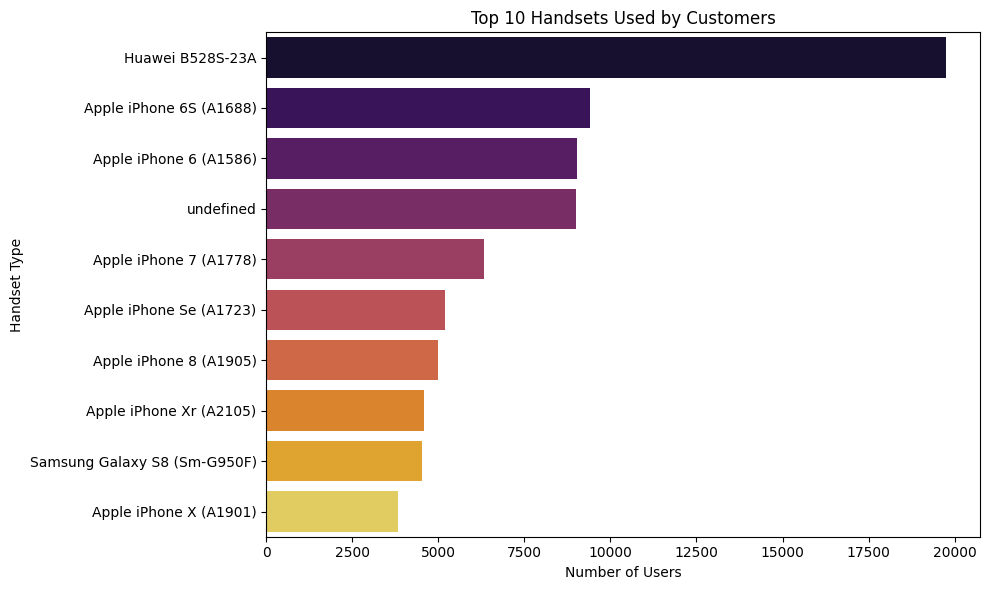

In [ ]:
plt.figure(figsize=(10, 6))
# Extract 1D arrays for x and y values
sns.barplot(x=top_handset_types['Count'].values, y=top_handset_types.index, palette='inferno')
plt.title('Top 10 Handsets Used by Customers')
plt.xlabel('Number of Users')
plt.ylabel('Handset Type')
plt.tight_layout()
plt.show()

Identify the top 3 handset manufacturers

In [ ]:
def analyze_handset_manufacturer(Telcom_data, top_n=3):

    if 'Handset Manufacturer' in Telcom_data.columns:
        # Extract 'Handset Manufacturer' column
        manufacturer_series = Telcom_data['Handset Manufacturer']

        # Count occurrences
        manufacturer_counts = manufacturer_series.value_counts()

        # Sort values
        sorted_manufacturers = manufacturer_counts.sort_values(ascending=False)

        # Get the top values
        top_manufacturers = sorted_manufacturers.head(top_n)

        return top_manufacturers.to_frame(name='Count')
    else:
        raise ValueError("Column 'Handset Manufacturer' not found in the DataFrame.")

# print
top_handset_manufacturers = analyze_handset_manufacturer(Telcom_data, top_n=3)
("Top Handset Manufacturers:")
(top_handset_manufacturers)

,Count
Handset Manufacturer,
Apple,59565
Samsung,40839
Huawei,34423


Visualizing the Results

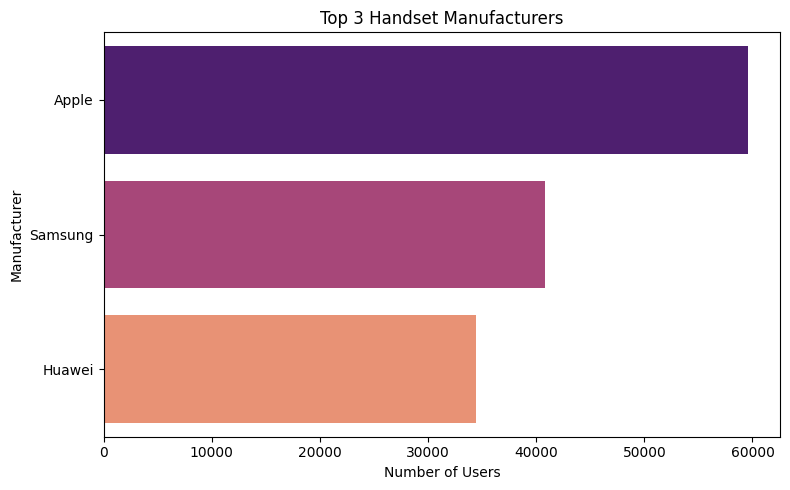

In [ ]:
# Assuming 'top_handset_manufacturers' from your previous code is the DataFrame you want to plot
plt.figure(figsize=(8, 5))
sns.barplot(x=top_handset_manufacturers['Count'].values[:3],
            y=top_handset_manufacturers.index[:3],
            palette='magma')
plt.title('Top 3 Handset Manufacturers')
plt.xlabel('Number of Users')
plt.ylabel('Manufacturer')
plt.tight_layout()
plt.show()

. Identify the top 5 handsets per top 3 handset manufacturer:

In [ ]:
def top_handsets_per_manufacturer_df(Telcom_data, top_manufacturer_count=3, top_handset_count=5):

    if 'Handset Manufacturer' in Telcom_data.columns and 'Handset Type' in Telcom_data.columns:
        # Identify the top N handset manufacturers
        top_manufacturers = Telcom_data['Handset Manufacturer'].value_counts().head(top_manufacturer_count).index

        top_handsets_dict = {}
        for manufacturer in top_manufacturers:
            # Filter DataFrame for each manufacturer
            manufacturer_df = Telcom_data[Telcom_data['Handset Manufacturer'] == manufacturer]

            # Identify the top handsets for the current manufacturer
            top_handsets = manufacturer_df['Handset Type'].value_counts().head(top_handset_count).reset_index()
            top_handsets.columns = ['Handset Type', 'Count']
            top_handsets_dict[manufacturer] = top_handsets

        return top_handsets_dict
    else:
        raise ValueError("Required columns ('Handset Manufacturer' and 'Handset Type') not found in the DataFrame.")

# Example usage:
top_handsets_per_manufacturer_df_result = top_handsets_per_manufacturer_df(Telcom_data)
print("\nTop 5 Handsets per Top 3 Handset Manufacturers:")
for manufacturer, handset_df in top_handsets_per_manufacturer_df_result.items():
    print(f"\n{manufacturer}:\n{handset_df}")


Top 5 Handsets per Top 3 Handset Manufacturers:

Apple:
              Handset Type  Count
0  Apple iPhone 6S (A1688)   9419
1   Apple iPhone 6 (A1586)   9023
2   Apple iPhone 7 (A1778)   6326
3  Apple iPhone Se (A1723)   5187
4   Apple iPhone 8 (A1905)   4993

Samsung:
                   Handset Type  Count
0  Samsung Galaxy S8 (Sm-G950F)   4520
1    Samsung Galaxy A5 Sm-A520F   3724
2   Samsung Galaxy J5 (Sm-J530)   3696
3   Samsung Galaxy J3 (Sm-J330)   3484
4  Samsung Galaxy S7 (Sm-G930X)   3199

Huawei:
                     Handset Type  Count
0                Huawei B528S-23A  19752
1                    Huawei E5180   2079
2  Huawei P20 Lite Huawei Nova 3E   2021
3                      Huawei P20   1480
4                  Huawei Y6 2018    997


Visualizing the Results

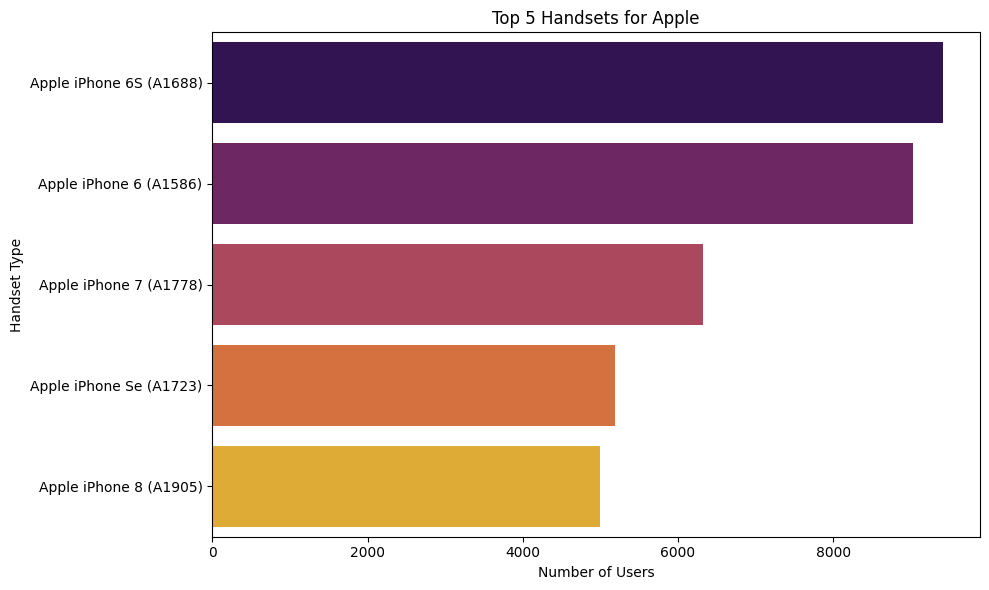

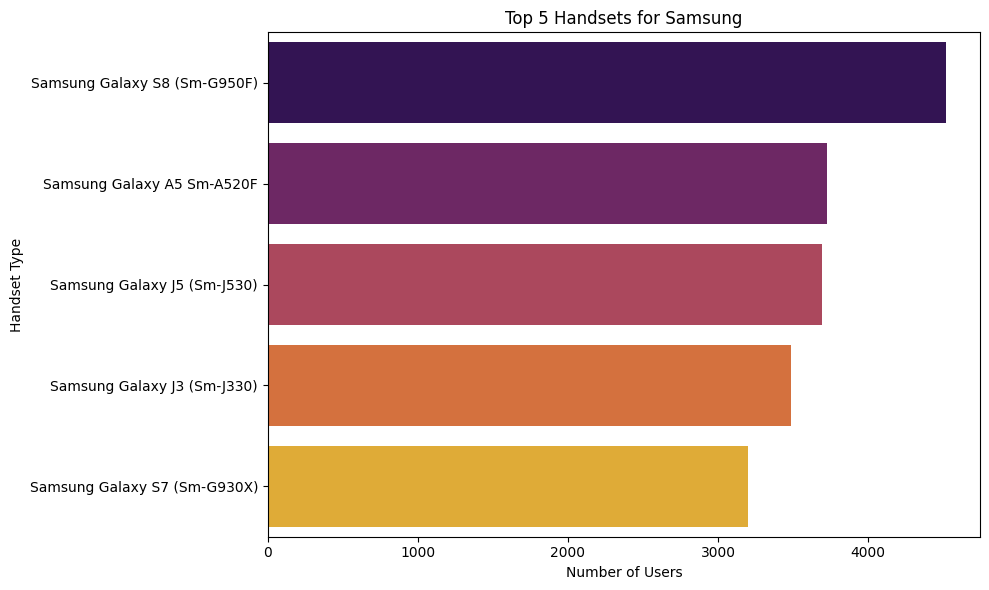

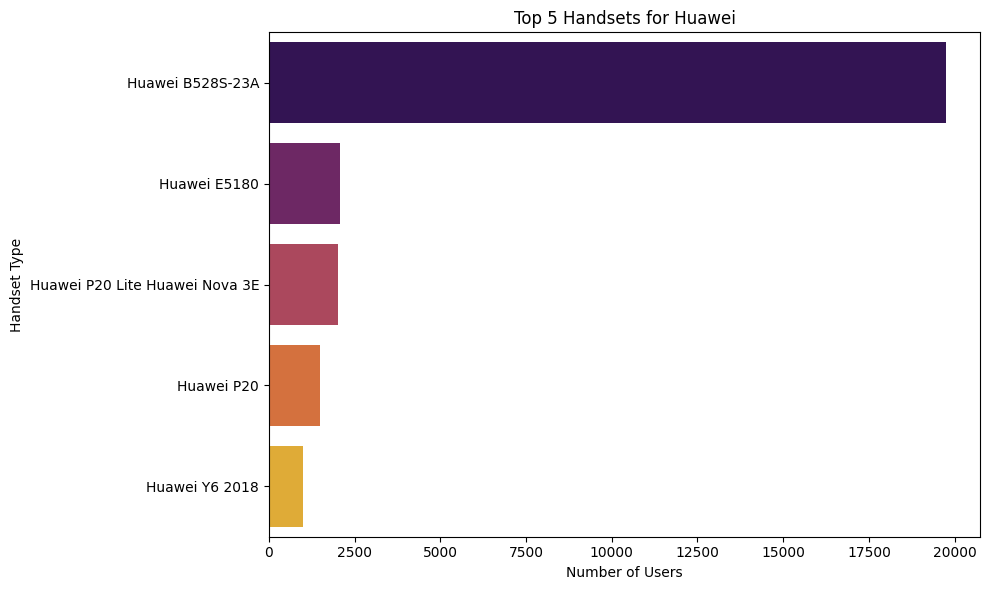

In [ ]:
# Use the result of your function call
for manufacturer, handsets in top_handsets_per_manufacturer_df_result.items():
    plt.figure(figsize=(10, 6))

    # Access the 'Count' and 'Handset Type' columns of the DataFrame
    sns.barplot(x=handsets['Count'], y=handsets['Handset Type'], palette='inferno')

    plt.title(f'Top 5 Handsets for {manufacturer}')
    plt.xlabel('Number of Users')
    plt.ylabel('Handset Type')
    plt.tight_layout()
    plt.show()

Make a short interpretation and recommendation to marketing teams

Stemming the data usage for each application

In [ ]:
application_columns = [
    'Social Media DL (Bytes)', 'Social Media UL (Bytes)',
    'Google DL (Bytes)', 'Google UL (Bytes)',
    'Email DL (Bytes)', 'Email UL (Bytes)',
    'Youtube DL (Bytes)', 'Youtube UL (Bytes)',
    'Netflix DL (Bytes)', 'Netflix UL (Bytes)',
    'Gaming DL (Bytes)', 'Gaming UL (Bytes)',
    'Other DL (Bytes)', 'Other UL (Bytes)'
]

# Summarize data usage for each application
total_usage = Telcom_data[application_columns].sum()
print(total_usage)

Social Media DL (Bytes)    2.693001e+11
Social Media UL (Bytes)    4.939298e+09
Google DL (Bytes)          8.626186e+11
Google UL (Bytes)          3.084833e+11
Email DL (Bytes)           2.687611e+11
Email UL (Bytes)           7.010648e+10
Youtube DL (Bytes)         1.745123e+12
Youtube UL (Bytes)         1.651423e+12
Netflix DL (Bytes)         1.744039e+12
Netflix UL (Bytes)         1.650274e+12
Gaming DL (Bytes)          6.330713e+13
Gaming UL (Bytes)          1.243268e+12
Other DL (Bytes)           6.316550e+13
Other UL (Bytes)           1.239728e+12
dtype: float64


Analyze Distribution and Trends

In [ ]:
summary_Telcom_data = Telcom_data[application_columns].sum().reset_index()
summary_Telcom_data.columns = ['Application', 'Total Bytes']
summary_Telcom_data['Total MB'] = summary_Telcom_data['Total Bytes'] / (1024 ** 2)  # Convert to MB
summary_Telcom_data = summary_Telcom_data.sort_values(by='Total MB', ascending=False)
print(summary_Telcom_data)

                Application   Total Bytes      Total MB
10        Gaming DL (Bytes)  6.330713e+13  6.037438e+07
12         Other DL (Bytes)  6.316550e+13  6.023932e+07
6        Youtube DL (Bytes)  1.745123e+12  1.664279e+06
8        Netflix DL (Bytes)  1.744039e+12  1.663246e+06
7        Youtube UL (Bytes)  1.651423e+12  1.574919e+06
9        Netflix UL (Bytes)  1.650274e+12  1.573824e+06
11        Gaming UL (Bytes)  1.243268e+12  1.185673e+06
13         Other UL (Bytes)  1.239728e+12  1.182297e+06
2         Google DL (Bytes)  8.626186e+11  8.226572e+05
3         Google UL (Bytes)  3.084833e+11  2.941926e+05
0   Social Media DL (Bytes)  2.693001e+11  2.568246e+05
4          Email DL (Bytes)  2.687611e+11  2.563106e+05
5          Email UL (Bytes)  7.010648e+10  6.685875e+04
1   Social Media UL (Bytes)  4.939298e+09  4.710482e+03


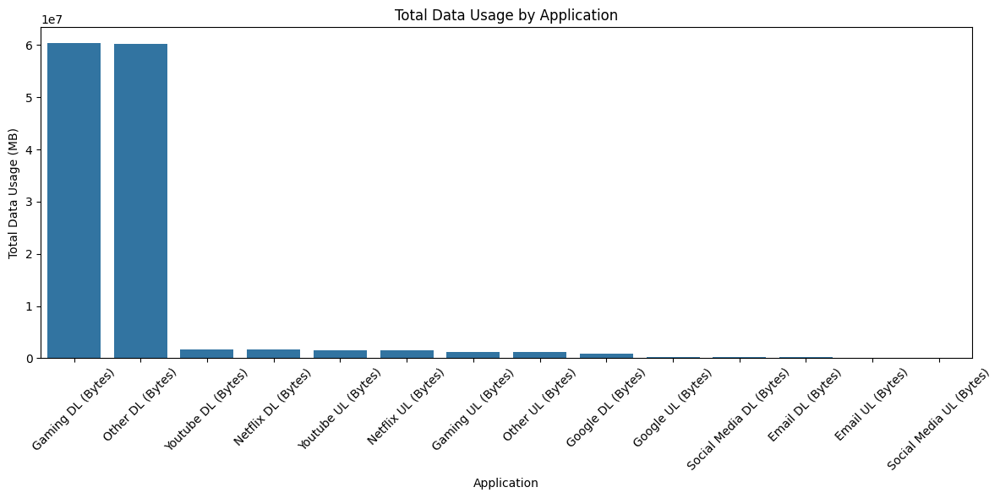

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x='Application', y='Total MB', data=summary_Telcom_data)
plt.title('Total Data Usage by Application')
plt.xlabel('Application')
plt.ylabel('Total Data Usage (MB)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Conducting User Behavior Analysis through xDR Data

In [ ]:
social_media_usage = Telcom_data[['Social Media DL (Bytes)', 'Social Media UL (Bytes)']].sum()
print(social_media_usage)

Social Media DL (Bytes)    2.693001e+11
Social Media UL (Bytes)    4.939298e+09
dtype: float64


Create a column for total data volume per application (DL + UL)

In [ ]:
for app in ['Social Media', 'Google', 'Email', 'Youtube', 'Netflix', 'Gaming', 'Other']:
    Telcom_data[f'{app} Total (Bytes)'] = Telcom_data[f'{app} DL (Bytes)'] + Telcom_data[f'{app} UL (Bytes)']

Aggregate per user

In [ ]:
user_behavior = Telcom_data.groupby('MSISDN/Number').agg({
    'Bearer Id': 'count',  # Number of xDR sessions
    'Dur. (ms)': 'sum',    # Total session duration
    'Total DL (Bytes)': 'sum',  # Total download data
    'Total UL (Bytes)': 'sum',  # Total upload data
    **{col: 'sum' for col in application_columns},  # Total data volume for each application
    **{f'{app} Total (Bytes)': 'sum' for app in ['Social Media', 'Google', 'Email', 'Youtube', 'Netflix', 'Gaming', 'Other']}
}).reset_index()

Rename columns for clarity

In [ ]:
user_behavior.rename(columns={
    'Bearer_Id': 'Number of xDR Sessions'
}, inplace=True)

print(user_behavior.head())

   MSISDN/Number  Bearer Id  Dur. (ms)  Total DL (Bytes)  Total UL (Bytes)  \
0    33601001722          1     116720      8.426375e+08          36053108   
1    33601001754          1     181230      1.207552e+08          36104459   
2    33601002511          1     134969      5.566597e+08          39306820   
3    33601007832          1      49878      4.019932e+08          20327526   
4    33601008617          2      37104      1.363130e+09          94280527   

   Social Media DL (Bytes)  Social Media UL (Bytes)  Google DL (Bytes)  \
0                2206504.0                  25631.0          3337123.0   
1                2598548.0                  62017.0          4197697.0   
2                3148004.0                  47619.0          3343483.0   
3                 251469.0                  28825.0          5937765.0   
4                2861230.0                  51312.0         13728668.0   

   Google UL (Bytes)  Email DL (Bytes)  Email UL (Bytes)  Youtube DL (Bytes)  \
0     

In [ ]:
user_behavior.rename(columns={
    'Dur. (ms)': 'Total Session Duration (ms)'
}, inplace=True)

print(user_behavior.head())

   MSISDN/Number  Bearer Id  Total Session Duration (ms)  Total DL (Bytes)  \
0    33601001722          1                       116720      8.426375e+08   
1    33601001754          1                       181230      1.207552e+08   
2    33601002511          1                       134969      5.566597e+08   
3    33601007832          1                        49878      4.019932e+08   
4    33601008617          2                        37104      1.363130e+09   

   Total UL (Bytes)  Social Media DL (Bytes)  Social Media UL (Bytes)  \
0          36053108                2206504.0                  25631.0   
1          36104459                2598548.0                  62017.0   
2          39306820                3148004.0                  47619.0   
3          20327526                 251469.0                  28825.0   
4          94280527                2861230.0                  51312.0   

   Google DL (Bytes)  Google UL (Bytes)  Email DL (Bytes)  Email UL (Bytes)  \
0          33

In [ ]:
Telcom_data['Start'] = Telcom_data['Start'].fillna(Telcom_data['Start'].mode()[0])

Telcom_data['End'] = Telcom_data['End'].fillna(Telcom_data['End'].mode()[0])

Telcom_data['Last Location Name'] = Telcom_data['Last Location Name'].fillna(Telcom_data['Last Location Name'].mode()[0])

Telcom_data['Handset Manufacturer'] = Telcom_data['Handset Manufacturer'].fillna(Telcom_data['Handset Manufacturer'].mode()[0])

Telcom_data['Handset Type'] = Telcom_data['Handset Type'].fillna(Telcom_data['Handset Type'].mode()[0])

Telcom_data['MSISDN/Number'] = Telcom_data['Handset Type'].fillna(Telcom_data['Handset Type'].mode()[0])

In [ ]:
Telcom_data = Telcom_data.drop(['Start', 'End', 'Last Location Name', 'Handset Type', 'Handset Manufacturer'], axis=1)

In [ ]:
Telcom_data.head()

,Bearer Id,Start ms,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
0,13114483460844900352,770,662,1823652,208201448079117,Samsung Galaxy A5 Sm-A520F,35521209507511,42,5,23,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,37624.0,38787.0,1823652892,128,52,164,8,288,8,213,214,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741,308879636.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0
1,13114483482878900224,235,606,1365104,208201909211140,Samsung Galaxy J5 (Sm-J530),35794009006359,65,5,16,26,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,168.0,3560.0,1365104371,128,52,164,8,288,8,971,1022,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391,653384965.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0
2,13114483484080500736,1,652,1361762,208200314458056,Samsung Galaxy A8 (2018),35281510359387,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1361762651,128,52,164,8,288,8,751,695,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638,279807335.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0
3,13114483485442799616,486,171,1321509,208201402342131,undefined,35356610164913,45,5,44,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,3330.0,37882.0,1321509685,128,52,164,8,288,8,17,207,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218,846028530.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0
4,13114483499480700928,565,954,1089009,208201401415120,Samsung Sm-G390F,35407009745539,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1089009389,128,52,164,8,288,8,607,604,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814,569138589.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0


In [ ]:
# Drop missing values in identification columns
identification_columns = ['IMSI', 'MSISDN/Number', 'IMEI']
Cleaned_Telcom_data = Telcom_data.dropna(subset=identification_columns)
Telcom_data = Cleaned_Telcom_data

In [ ]:
# Impute missing values in quality of service metrics using mean
quality_of_service_columns = ['Avg RTT DL (ms)', 'Avg Bearer TP DL (kbps)', 'TCP DL Retrans. Vol (Bytes)']

for col in quality_of_service_columns:
    if col in Telcom_data.columns:
        # Use Telcom_data[col] to calculate the mean for the current column
        Telcom_data[col] = Telcom_data[col].fillna(Telcom_data[col].mean())
    else:
        print(f"Column '{col}' not found in the DataFrame.")
quality_of_service_columns

['Avg RTT DL (ms)', 'Avg Bearer TP DL (kbps)', 'TCP DL Retrans. Vol (Bytes)']

In [ ]:
# Assuming you have defined the fix_missing_ffill function
def fix_missing_ffill(Telcom_data, column):
    Telcom_data[column].fillna(method='ffill', inplace=True)
    return Telcom_data

# Assuming you have a DataFrame called 'clean_df'
percentage_metrics_columns = ['DL TP < 50 Kbps (%)', 'UL TP > 300 Kbps (%)']
for col in percentage_metrics_columns:
    Telcom_data = fix_missing_ffill(Telcom_data, col)

# Display the resulting DataFrame
Telcom_data.head()

,Bearer Id,Start ms,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
0,13114483460844900352,770,662,1823652,208201448079117,Samsung Galaxy A5 Sm-A520F,35521209507511,42,5,23,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,37624.0,38787.0,1823652892,128,52,164,8,288,8,213,214,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741,308879636.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0
1,13114483482878900224,235,606,1365104,208201909211140,Samsung Galaxy J5 (Sm-J530),35794009006359,65,5,16,26,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,168.0,3560.0,1365104371,128,52,164,8,288,8,971,1022,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391,653384965.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0
2,13114483484080500736,1,652,1361762,208200314458056,Samsung Galaxy A8 (2018),35281510359387,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1361762651,128,52,164,8,288,8,751,695,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638,279807335.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0
3,13114483485442799616,486,171,1321509,208201402342131,undefined,35356610164913,45,5,44,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,3330.0,37882.0,1321509685,128,52,164,8,288,8,17,207,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218,846028530.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0
4,13114483499480700928,565,954,1089009,208201401415120,Samsung Sm-G390F,35407009745539,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1089009389,128,52,164,8,288,8,607,604,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814,569138589.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0


In [ ]:
# Impute missing values in content-specific columns using forward fill
content_columns = ['Social Media DL (Bytes)', 'Netflix UL (Bytes)']
for col in content_columns:
    Telcom_data = fix_missing_ffill(Telcom_data, col)
Telcom_data.head()

,Bearer Id,Start ms,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
0,13114483460844900352,770,662,1823652,208201448079117,Samsung Galaxy A5 Sm-A520F,35521209507511,42,5,23,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,37624.0,38787.0,1823652892,128,52,164,8,288,8,213,214,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741,308879636.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0
1,13114483482878900224,235,606,1365104,208201909211140,Samsung Galaxy J5 (Sm-J530),35794009006359,65,5,16,26,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,168.0,3560.0,1365104371,128,52,164,8,288,8,971,1022,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391,653384965.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0
2,13114483484080500736,1,652,1361762,208200314458056,Samsung Galaxy A8 (2018),35281510359387,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1361762651,128,52,164,8,288,8,751,695,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638,279807335.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0
3,13114483485442799616,486,171,1321509,208201402342131,undefined,35356610164913,45,5,44,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,3330.0,37882.0,1321509685,128,52,164,8,288,8,17,207,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218,846028530.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0
4,13114483499480700928,565,954,1089009,208201401415120,Samsung Sm-G390F,35407009745539,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1089009389,128,52,164,8,288,8,607,604,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814,569138589.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0


In [ ]:
# Impute missing values in general download/upload columns using mean
general_columns = ['Total UL (Bytes)', 'Total DL (Bytes)']
for col in general_columns:
    Telcom_data[col] = Telcom_data[col].fillna(Telcom_data[col].mean())

Telcom_data[col]

,Total DL (Bytes)
0,308879636.0
1,653384965.0
2,279807335.0
3,846028530.0
4,569138589.0
5,754452212.0
6,70562047.0
7,775350343.0
8,861612261.0
9,850570347.0


Describe the data types of each column

In [ ]:
# Describe the data types of each column
Telcom_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 57 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   Bearer Id                                 150001 non-null  object 
 1   Start ms                                  150001 non-null  int64  
 2   End ms                                    150001 non-null  int64  
 3   Dur. (ms)                                 150001 non-null  int64  
 4   IMSI                                      150001 non-null  int64  
 5   MSISDN/Number                             150001 non-null  object 
 6   IMEI                                      150001 non-null  int64  
 7   Avg RTT DL (ms)                           150001 non-null  int64  
 8   Avg RTT UL (ms)                           150001 non-null  int64  
 9   Avg Bearer TP DL (kbps)                   150001 non-null  int64  
 10  Avg Bearer TP UL (kb

In [ ]:
Telcom_data.head()

,Bearer Id,Start ms,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
0,13114483460844900352,770,662,1823652,208201448079117,Samsung Galaxy A5 Sm-A520F,35521209507511,42,5,23,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,37624.0,38787.0,1823652892,128,52,164,8,288,8,213,214,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741,308879636.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0
1,13114483482878900224,235,606,1365104,208201909211140,Samsung Galaxy J5 (Sm-J530),35794009006359,65,5,16,26,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,168.0,3560.0,1365104371,128,52,164,8,288,8,971,1022,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391,653384965.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0
2,13114483484080500736,1,652,1361762,208200314458056,Samsung Galaxy A8 (2018),35281510359387,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1361762651,128,52,164,8,288,8,751,695,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638,279807335.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0
3,13114483485442799616,486,171,1321509,208201402342131,undefined,35356610164913,45,5,44,44,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,3330.0,37882.0,1321509685,128,52,164,8,288,8,17,207,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218,846028530.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0
4,13114483499480700928,565,954,1089009,208201401415120,Samsung Sm-G390F,35407009745539,45,5,6,9,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,0.0,0.0,1089009389,128,52,164,8,288,8,607,604,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814,569138589.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0


In [ ]:
Telcom_data.tail()

,Bearer Id,Start ms,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
149996,7277825670196679680,451,214,81230,208202201200072,Apple iPhone 8 Plus (A1897),35483109451938,32,0,52,65,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,42376.0,41915.0,81230763,128,52,164,8,288,8,223,229,3.464974e+06,52091.00000,9.967603e+06,2.817311e+06,5.763900e+04,633237.00000,1.619167e+07,1.176343e+07,1.788370e+07,1.967816e+07,5.266097e+08,9.197207e+06,3.264510e+06,1.348742e+07,57628851,574175259.0,3.517065e+06,1.278491e+07,6.908760e+05,2.795510e+07,3.756186e+07,5.358069e+08,1.675193e+07
149997,7349883264234609664,483,187,97970,208201908153249,Apple iPhone Se (A1723),35660508296467,27,2,23,54,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,17264.0,16759.0,97970704,128,52,164,8,288,8,105,102,2.344568e+06,7613.00000,2.229420e+06,2.185941e+06,1.954414e+06,167304.00000,1.387723e+07,8.288284e+06,1.935015e+07,2.129315e+07,6.268931e+08,4.735033e+06,7.121804e+08,2.457758e+06,39135081,666648844.0,2.352181e+06,4.415361e+06,2.121718e+06,2.216552e+07,4.064329e+07,6.316281e+08,7.146381e+08
149998,13114483573367300096,283,810,98249,208201711161187,Apple iPhone Xs (A2097),35721209870907,43,6,43,47,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,25003.0,28640.0,98249527,128,52,164,8,288,8,104,108,1.245845e+06,14394.00000,3.850890e+06,2.734579e+06,1.525734e+06,532543.00000,2.266051e+07,1.855903e+06,9.963942e+06,5.065760e+06,5.535395e+08,1.339432e+07,1.211009e+08,1.131473e+07,34912224,592786405.0,1.260239e+06,6.585469e+06,2.058277e+06,2.451641e+07,1.502970e+07,5.669338e+08,1.324156e+08
149999,13114483573367300096,696,327,97910,208202101098075,Huawei Fig-Lx1,86186204011457,37,5,34,37,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,13405.0,34088.0,97910631,128,52,164,8,288,8,43,82,8.015470e+05,21562.00000,4.189773e+06,3.567494e+06,2.228270e+06,622644.00000,8.817106e+06,8.305402e+06,3.322253e+06,1.317259e+07,3.525370e+08,2.529475e+06,8.147131e+08,1.406930e+06,29626096,371895920.0,8.231090e+05,7.757267e+06,2.850914e+06,1.712251e+07,1.649484e+07,3.550664e+08,8.161200e+08
150000,,499,500,86399,208201546329113,Unknown,35722009426311,45,5,63,63,568730,20949.5,100,0,0,0,100,0,0,0,1941949,229733,39304.5,46793.5,86399983,128,52,164,8,288,8,203,217,1.795322e+06,32928.43438,5.750753e+06,2.056542e+06,1.791729e+06,467373.44194,1.163407e+07,1.100941e+07,1.162685e+07,1.100175e+07,4.220447e+08,8.288398e+06,4.211005e+08,8.264799e+06,41143312,455841077.5,1.828250e+06,7.807295e+06,2.259102e+06,2.264348e+07,2.262861e+07,4.303331e+08,4.293653e+08


Basic Metrics Analysis

In [ ]:
Telcom_data.describe()

,Start ms,End ms,Dur. (ms),IMSI,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),Social Media Total (Bytes),Google Total (Bytes),Email Total (Bytes),Youtube Total (Bytes),Netflix Total (Bytes),Gaming Total (Bytes),Other Total (Bytes)
count,150001.000000,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.00000,150001.000000,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,1.500010e+05,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,150001.000000,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05,1.500010e+05
mean,499.188199,498.800888,1.046084e+05,2.082016e+14,4.842592e+13,97.774455,15.315031,13299.95768,1770.417264,8.915464e+06,2.836918e+05,92.880721,3.053926,1.708709,1.601563,98.537903,0.772648,0.147206,0.078506,5.335014e+07,1.599258e+06,1.829165e+06,1.408871e+06,1.046090e+08,429.380437,161.810088,407.273925,26.595896,566.589716,41.910741,3702.086506,4001.967380,1.795322e+06,32928.434380,5.750753e+06,2.056542e+06,1.791729e+06,467373.441940,1.163407e+07,1.100941e+07,1.162685e+07,1.100175e+07,4.220447e+08,8.288398e+06,4.211005e+08,8.264799e+06,4.112121e+07,4.546434e+08,1.828250e+06,7.807295e+06,2.259102e+06,2.264348e+07,2.262861e+07,4.303331e+08,4.293653e+08
std,288.610872,288.096693,8.103736e+04,2.144723e+10,2.238739e+13,559.909444,76.687998,23971.82300,4625.342183,1.176582e+08,1.578013e+07,13.015062,6.203391,4.150848,4.818083,4.623262,3.217143,1.620264,1.291984,6.534314e+08,1.328031e+07,5.696378e+06,4.643216e+06,8.103736e+07,1561.058302,902.741156,1172.379095,444.892070,1291.897534,504.359383,9151.882524,10137.187735,1.035482e+06,19006.178256,3.309097e+06,1.189917e+06,1.035840e+06,269969.307031,6.710569e+06,6.345423e+06,6.725218e+06,6.359490e+06,2.439675e+08,4.782700e+06,2.432050e+08,4.769004e+06,1.127635e+07,2.441421e+08,1.035646e+06,3.516420e+06,1.071109e+06,9.246800e+06,9.260820e+06,2.440199e+08,2.432681e+08
min,0.000000,0.000000,7.142000e+03,2.040471e+14,4.400152e+11,0.000000,0.000000,0.00000,0.000000,2.000000e+00,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000e+01,4.000000e+01,0.000000e+00,0.000000e+00,7.142988e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.200000e+01,0.000000,2.070000e+02,3.000000e+00,1.400000e+01,2.000000,5.300000e+01,1.050000e+02,4.200000e+01,3.500000e+01,2.516000e+03,5.900000e+01,3.290000e+03,1.480000e+02,2.866892e+06,7.114041e+06,1.563000e+03,4.033000e+04,8.359000e+03,7.890300e+04,9.843200e+04,3.063580e+05,1.490450e+05
25%,250.000000,251.000000,5.744200e+04,2.082014e+14,3.546261e+13,35.000000,3.000000,43.00000,47.00000

Non-Graphical Univariate Analysis

In [ ]:
dispersion_params = Telcom_data.select_dtypes(include=['float64', 'int64']).agg(['mean', 'std', 'var', 'min', 'max'])
print(dispersion_params)

          Start ms        End ms     Dur. (ms)          IMSI          IMEI  \
mean    499.188199    498.800888  1.046084e+05  2.082016e+14  4.842592e+13   
std     288.610872    288.096693  8.103736e+04  2.144723e+10  2.238739e+13   
var   83296.235554  82999.704454  6.567055e+09  4.599835e+20  5.011953e+26   
min       0.000000      0.000000  7.142000e+03  2.040471e+14  4.400152e+11   
max     999.000000    999.000000  1.859336e+06  2.140743e+14  9.900120e+13   

      Avg RTT DL (ms)  Avg RTT UL (ms)  Avg Bearer TP DL (kbps)  \
mean        97.774455        15.315031             1.329996e+04   
std        559.909444        76.687998             2.397182e+04   
var     313498.585409      5881.048988             5.746483e+08   
min          0.000000         0.000000             0.000000e+00   
max      96923.000000      7120.000000             3.781600e+05   

      Avg Bearer TP UL (kbps)  TCP DL Retrans. Vol (Bytes)  \
mean             1.770417e+03                 8.915464e+06   
std 

Graphical Univariate Analysis

Conduct a Graphical Univariate Analysis by identifying the most suitable plotting options for each variable and finding interpretation.

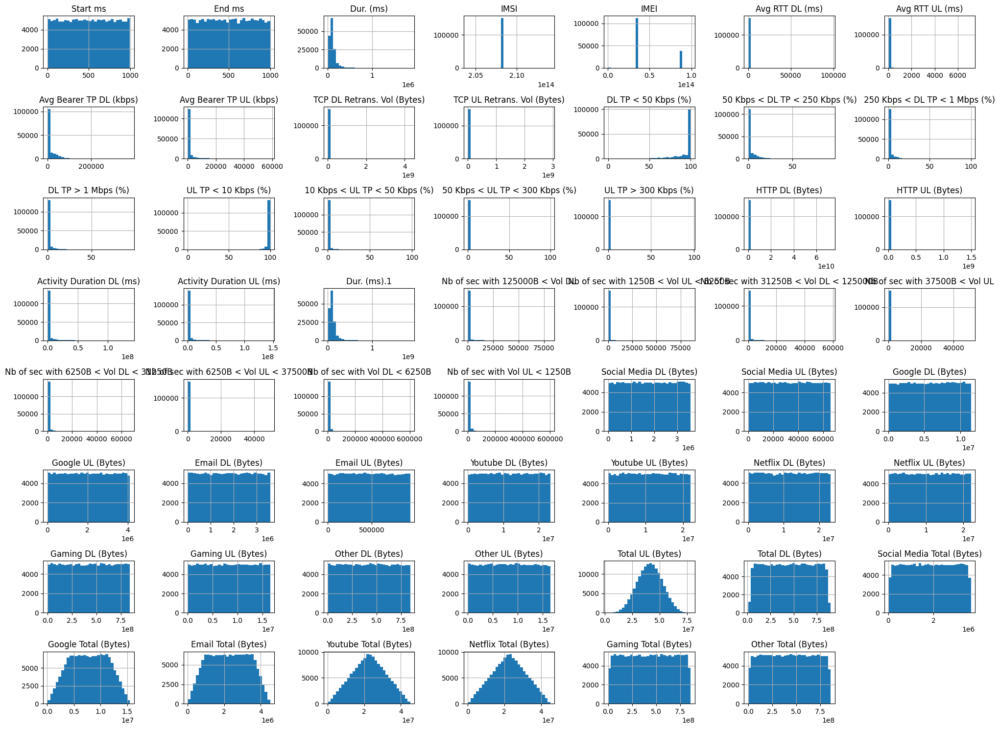

In [ ]:
Telcom_data.hist(bins=30, figsize=(20, 15))
plt.tight_layout()
plt.show()

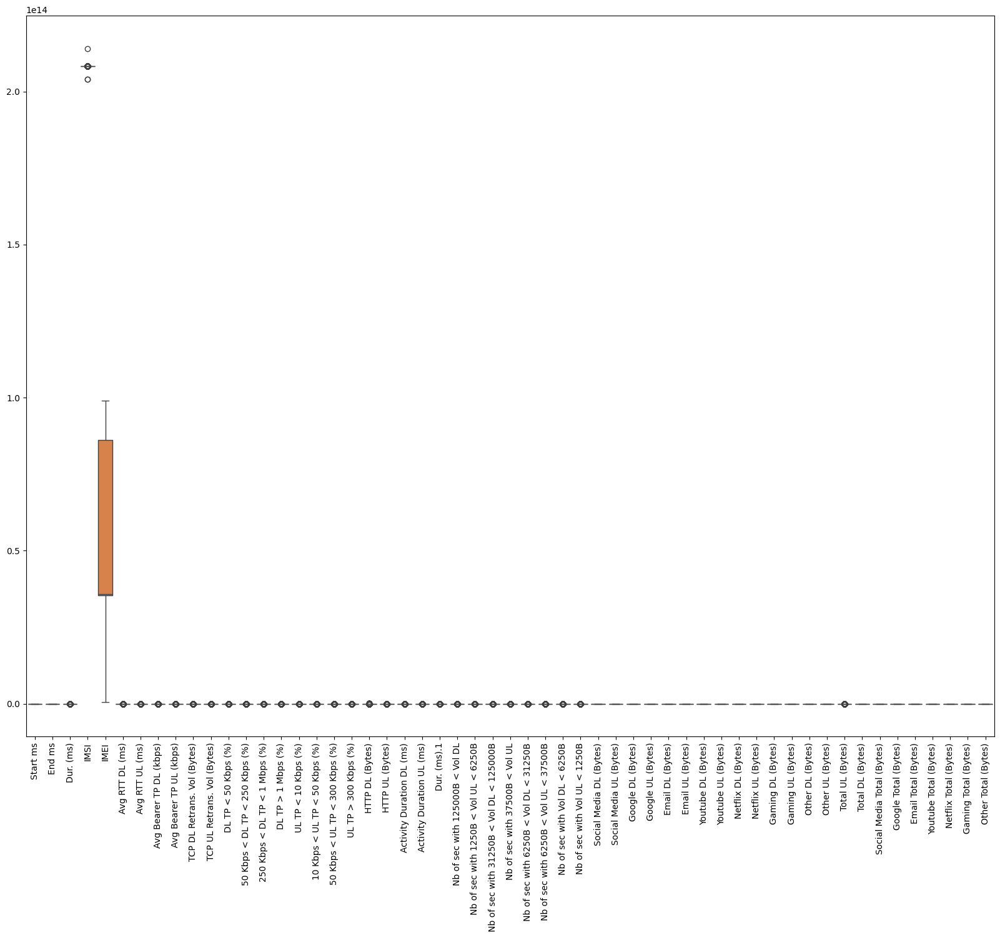

In [ ]:
# Boxplots for identifying outliers
plt.figure(figsize=(20, 15))
sns.boxplot(data=Telcom_data.select_dtypes(include=['float64', 'int64']))
plt.xticks(rotation=90)
plt.show()

Bivariate Analysis

Relationships between applications and total DL+UL data.

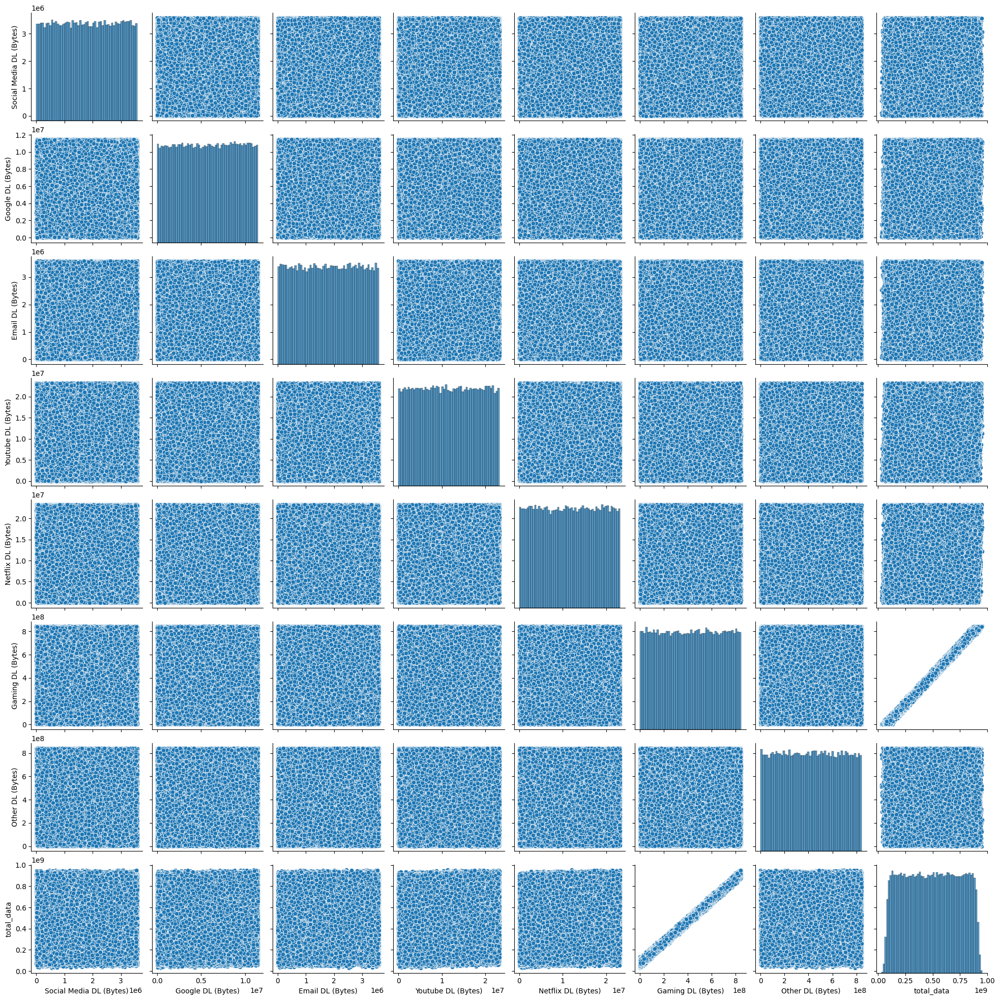

In [ ]:
Telcom_data['total_data'] = Telcom_data[['Total DL (Bytes)', 'Total UL (Bytes)']].sum(axis=1)

# Pairplot for bivariate analysis
sns.pairplot(Telcom_data[['Social Media DL (Bytes)', 'Google DL (Bytes)', 'Email DL (Bytes)', 'Youtube DL (Bytes)', 'Netflix DL (Bytes)', 'Gaming DL (Bytes)', 'Other DL (Bytes)', 'total_data']])
plt.show()

Transforming Data
Scaling and Normalization

Variable transformations – segment the users into the top five decile classes based on the total duration for all sessions and computation of the total data (DL+UL) per decile class.

In [ ]:
Telcom_data['decile_class'] = pd.qcut(Telcom_data['Dur. (ms)'], 5, labels=False)
decile_totals = Telcom_data.groupby('decile_class')[['Total DL (Bytes)', 'Total UL (Bytes)']].sum()
decile_totals['total_data'] = decile_totals.sum(axis=1)
print(decile_totals)

              Total DL (Bytes)  Total UL (Bytes)    total_data
decile_class                                                  
0                 1.364976e+13     1234287371672  1.488404e+13
1                 2.165800e+13     1962472030817  2.362047e+13
2                 5.580722e+12      506682183708  6.087404e+12
3                 1.362235e+13     1232586001756  1.485493e+13
4                 1.368615e+13     1232194499175  1.491834e+13


Correlation Analysis

In [ ]:
corr_matrix = Telcom_data[['Social Media DL (Bytes)', 'Google DL (Bytes)', 'Email DL (Bytes)',
                  'Youtube DL (Bytes)', 'Netflix DL (Bytes)', 'Gaming DL (Bytes)',
                  'Other DL (Bytes)']].corr()

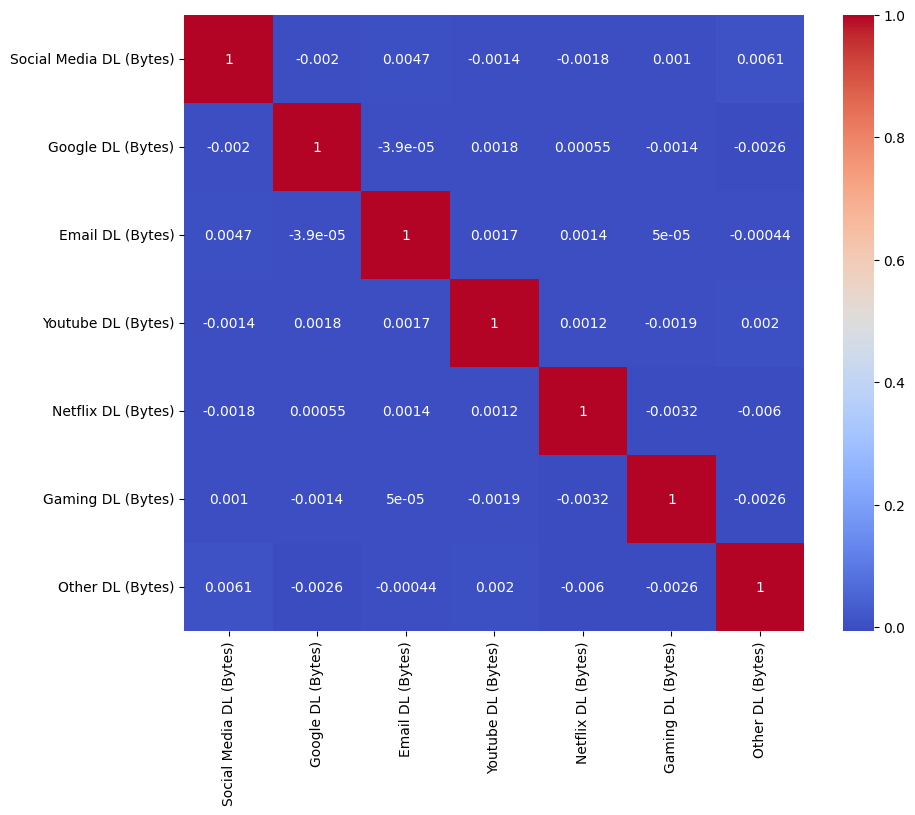

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()

Dimensionality Reduction (PCA)

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [ ]:
features = ['Social Media DL (Bytes)', 'Google DL (Bytes)', 'Email DL (Bytes)',
            'Youtube DL (Bytes)', 'Netflix DL (Bytes)', 'Gaming DL (Bytes)', 'Other DL (Bytes)']
x = Telcom_data[features].values
x = StandardScaler().fit_transform(x)

In [ ]:
pca = PCA(n_components=2)
principal_components = pca.fit_transform(x)
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
print(pca.explained_variance_ratio_)

[0.14439453 0.14355429]


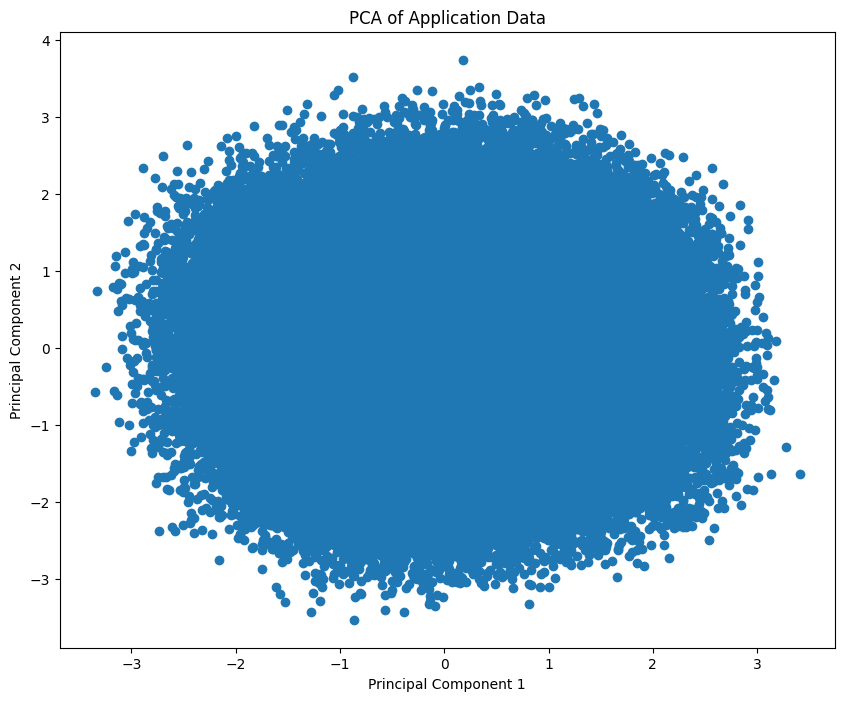

In [ ]:
plt.figure(figsize=(10, 8))
plt.scatter(pca_df['PC1'], pca_df['PC2'])
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Application Data')
plt.show()